# Use case example for PyHIST

## Objectives
* Sample five random WSIs from The Cancer Genome Atlas (TCGA) project from 6 different tissues: Brain, Breast, Colon, Kidney, Liver, Skin.
* Use __PyHIST__ to segment the WSIs and generate tiles (patches).
* Build a a tissue classifier (convolutional neural network) based on the tiles extracted from the WSIs.
* Isolate feature vectors from the last layer of the model for every tile.
* Perform dimensionality reduction (tSNE) over the feature vectors to identify clusters of tiles that share morphological similarities.

This test case is divided into three notebooks (parts A, B and C). In part A (the current notebook), we will prepare the data using PyHIST. In part B, we will fit the model, and in part C we will analyze the feature vectors. Set here the absolute paths (__with a trailing slash__) for the location of PyHIST, and for the folder that contains this notebook.

In [1]:
pyhist_path='/absolute/path/to/PyHIST/'
tutorial_path="/absolute/path/to/PyHIST/use_case/"

## Part A - WSI preparation (tile generation with PyHIST)

### Load the required libraries 

In [2]:
import os
import shutil
import pandas as pd
import subprocess as sub
import time
from PIL import Image
from IPython.display import display

### Select a random set of images to analyze per tissue

Manifest files containing IDs for every image can be obtained directly from TCGA at https://portal.gdc.cancer.gov/repository. Here, we provide a random sample of 5 WSIs for each tissue, based on these manifests. 

In [3]:
# Load the IDs
ids = pd.read_csv('TCGA.txt', sep = '\t')
ids.head()

,id,filename,md5,size,state,Tissue
0,c9e0e73a-6101-4948-8697-5aba7aa94765,TCGA-FG-5963-02A-01-TS1.821BB828-D37B-4AC2-835...,5f894ed293c18c502e527750d5259b76,226918287,released,brain
1,5d9438c9-b8fb-4d9a-9f76-b6a95400661c,TCGA-06-0128-01A-01-TS1.6307bd2c-9f54-48eb-954...,ec70dc4a22a9b1a0f7777aaaf4026b77,119915993,released,brain
2,53b36d8f-67c7-430b-b9ae-52690ec9e9c7,TCGA-14-3476-01B-01-BS1.e610ba8e-51f3-410a-925...,d0e620b51b7ae54ecb47f7e7f14793ce,84528267,released,brain
3,66dd6954-971f-4240-ae76-f5cbede92a3f,TCGA-06-0179-01A-02-BS2.41d633aa-5570-4810-a7e...,d794169f5f84cc7d9e0f4d83581daec7,241888975,released,brain
4,494a45a8-9ad1-4956-b628-164882dd01e9,TCGA-06-0148-01A-03-BS3.35ddb8d4-b43e-49f4-a89...,64616937d8407a02f6efa1dd3bfabc88,211383591,released,brain


In [4]:
ids.shape

(30, 6)

We will use these IDs to download the WSIs using the Genomic Data Commons' data transfer tool. We will download and unzip the tool. Please note that if you are not using Ubuntu, you will need to use a different version of the client. See more at: https://gdc.cancer.gov/access-data/gdc-data-transfer-tool

In [5]:
!wget https://gdc.cancer.gov/system/files/authenticated%20user/0/gdc-client_v1.5.0_Ubuntu_x64.zip

--2020-04-02 15:46:03--  https://gdc.cancer.gov/system/files/authenticated%20user/0/gdc-client_v1.5.0_Ubuntu_x64.zip
Resolving gdc.cancer.gov (gdc.cancer.gov)... 192.170.230.224, 2605:9a00:10:4008::101
Connecting to gdc.cancer.gov (gdc.cancer.gov)|192.170.230.224|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 13030166 (12M) [application/zip]
Saving to: ‘gdc-client_v1.5.0_Ubuntu_x64.zip’

100%[======================================>] 13,030,166  2.96MB/s   in 4.2s   

2020-04-02 15:46:08 (2.96 MB/s) - ‘gdc-client_v1.5.0_Ubuntu_x64.zip’ saved [13030166/13030166]



In [6]:
!unzip gdc-client_v1.5.0_Ubuntu_x64.zip
!rm gdc-client_v1.5.0_Ubuntu_x64.zip

Archive:  gdc-client_v1.5.0_Ubuntu_x64.zip
 extracting: gdc-client              


### Download images and then use PyHIST to segment those and generate patches

For each WSI, we will:
* Download the WSI in SVS format from TCGA.
* Generate the tiles using PyHIST.

   In the current example, we run PyHIST with the following parameters:
   * --percentage-bc 1: Use the outer 1% of the image to define background.
   * --borders 0000 --corners 1010: Consider only top left and bottom right corners of the image for background definition.
   * --content-threshold 0.4: Require at least 40% of foreground for the selected tiles.
   * --output-downsample 4: Downscale the output by a factor of 4 compared to the full resolution image.
   * --k-const 1000 
   * --minimum_segmentsize 1000: Since we perform the segmentation step in a high resolution version of the
   of the input (the default value for the mask downsampling is 16), it would be good to change the parameters
   for the segmentation as well.
   * --exclude-blank: Discard the tiles considered as background.
   * --save-tilecrossed-image: Produce a downscaled version of the input image, in which the selected tiles,
   that passed the content threshold filtering are marked with blue cross.
  
  
* Delete the whole-slide image.
* Move on to the next image.

In [7]:
# Create an output directory
if not os.path.exists('output/'):
    os.mkdir('output/')

In [8]:
t1 = time.time()
for i in range(ids.shape[0]):
    
    # Information for the current WSI
    img_id = ids.iloc[i]["id"]
    img_tissue = ids.iloc[i]["Tissue"]
    img_fname = ids.iloc[i]["filename"]
    
    # Download the current WSI
    os.chdir(tutorial_path)
    print("Downloading", str(i+1), "/", str(ids.shape[0]), ":", img_tissue, "WSI " + img_fname)
    process = sub.run(['./gdc-client', 'download', img_id], stdout=sub.PIPE)
    
    # Move it to the output directory and remove log files from the GDC client
    process = sub.run('mv '+ img_id +'/*.svs output/ && rm -r ' + img_id, stdout=sub.PIPE, shell=True)
    
    # Run PyHIST
    os.chdir(pyhist_path)
    print("Running PyHIST")
    img_path = "output/" + img_fname
    pyhist_arguments = " --save-tilecrossed-image \
    --borders 0000 \
    --corners 1010 \
    --percentage-bc 1 \
    --content-threshold 0.4 \
    --output-downsample 4 \
    --k-const 1000 \
    --minimum_segmentsize 1000 \
    --save-patches \
    --exclude-blank \
    --verbose \
    --output " + tutorial_path + "output/ "
    
    run_str = "python pyhist.py " + pyhist_arguments + tutorial_path + img_path
    process = sub.run(run_str, stdout = sub.PIPE, shell=True)
    
    # Remove SVS image
    process = sub.run('rm ' + tutorial_path + 'output/*.svs', stdout=sub.PIPE, shell=True)

t2 = time.time()
os.chdir(tutorial_path)
print("Elapsed time for download and segmentation: ", t2 - t1)

Running PyHIST
Running PyHIST
Running PyHIST
Running PyHIST
Running PyHIST
Running PyHIST
Running PyHIST
Running PyHIST
Running PyHIST
Running PyHIST
Running PyHIST
Running PyHIST
Running PyHIST
Running PyHIST
Running PyHIST
Running PyHIST
Running PyHIST
Running PyHIST
Running PyHIST
Running PyHIST
Running PyHIST
Running PyHIST
Running PyHIST
Running PyHIST
Running PyHIST
Running PyHIST
Running PyHIST
Running PyHIST
Running PyHIST
Running PyHIST
Elapsed time for download and segmentation:  5444.842268943787


#### Let's see how many tiles PyHIST produced in total:

In [9]:
!find . -name "TCGA*.png" | wc -l 

4720


### PyHIST - Output examples

Let's check a few examples of the segmentation output. The tiles produced and selected by PyHIST are marked with a _blue_ cross: only those with __tissue content__ are selected while the tiles containing background or noise are ignored. Here is an example for a breast WSI:

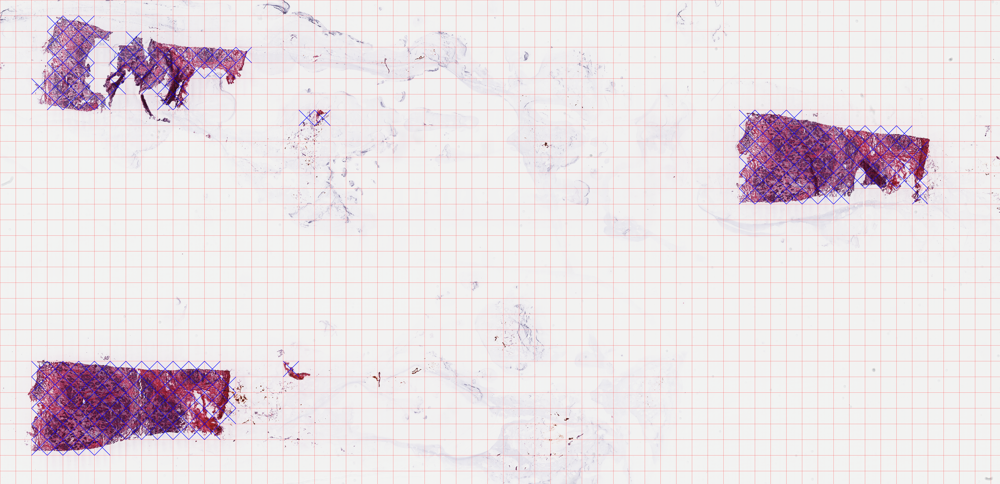

In [10]:
im = Image.open('output/TCGA-A2-A0EU-01A-02-MSB/tilecrossed_TCGA-A2-A0EU-01A-02-MSB.png')
display(im)

Segmentation works even with heterogeneous tissue sections. Here's another example for breast:

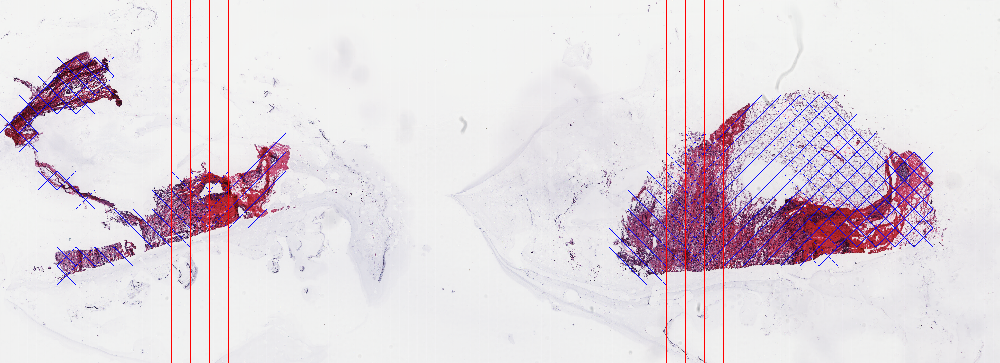

In [11]:
im = Image.open('output/TCGA-BH-A18F-01A-01-TSA/tilecrossed_TCGA-BH-A18F-01A-01-TSA.png')
display(im)

However, in a few cases is not possible to avoid background tiles that are enclosed by tissue.

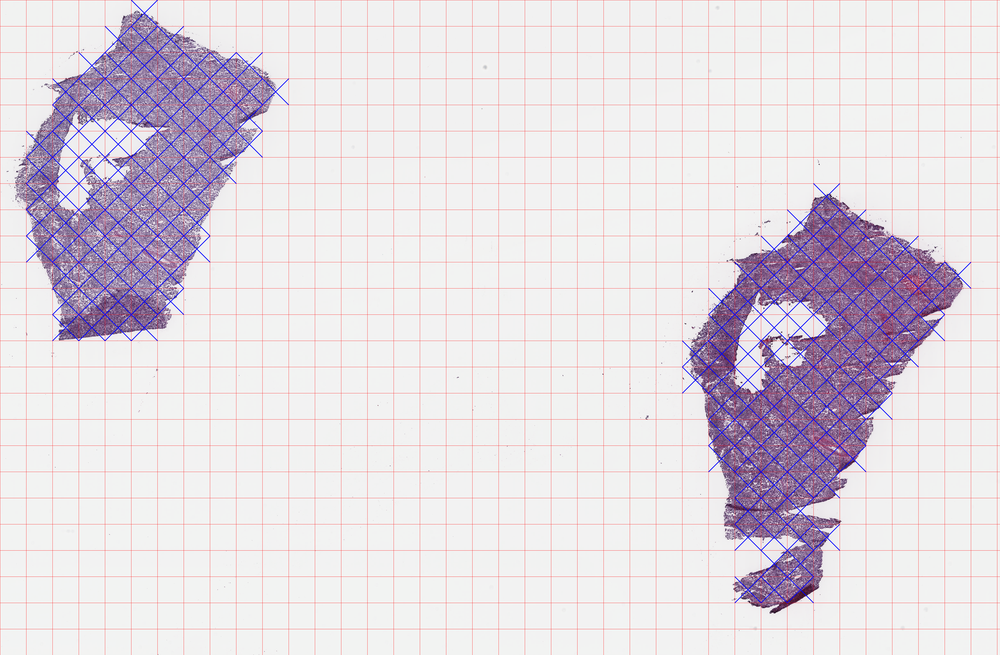

In [12]:
im = Image.open('output/TCGA-ER-A2NG-06A-01-TSA/tilecrossed_TCGA-ER-A2NG-06A-01-TSA.png')
display(im)

### Preparing the data to train a convolutional neural network

PyHIST outputs log files for each image indicating which tiles were selected or not. We will read these files and merge them:

In [13]:
# Change working directory to tutorial path
os.chdir(tutorial_path)

# First, we prepare the TCGA IDs to know which tissue belongs to each file
tmp = ids[["filename", "Tissue"]].copy()
tmp["filename"] = [x.split(".")[0] for x in ids["filename"].values]
tmp.set_index('filename', inplace=True)

# Traverse the log files
logs = []
for root, dirs, files in os.walk("output/"):
    for file in files:
        if file.endswith(".tsv"):
            
            # Read log file
            x = pd.read_csv(os.path.join(root, file), sep = "\t")
            
            # Create a column with the filename
            x["filename"] = [y.split("_")[0] for y in x["Tile"].values]
            
            # Append the tissue information
            x = x.join(tmp, on = "filename", how = "left")
            logs.append(x)
            
# Concatenate all data frames
logs = pd.concat(logs)

# Keep data only for the selected tiles
logs = logs[logs['Keep'] == 1]
logs.head()

,Tile,Width,Height,Keep,Row,Column,filename,Tissue
4,TCGA-G4-6321-01A-01-BS1_004,512,512,1,0,4,TCGA-G4-6321-01A-01-BS1,colon
5,TCGA-G4-6321-01A-01-BS1_005,512,512,1,0,5,TCGA-G4-6321-01A-01-BS1,colon
6,TCGA-G4-6321-01A-01-BS1_006,512,512,1,0,6,TCGA-G4-6321-01A-01-BS1,colon
19,TCGA-G4-6321-01A-01-BS1_019,512,512,1,1,4,TCGA-G4-6321-01A-01-BS1,colon
20,TCGA-G4-6321-01A-01-BS1_020,512,512,1,1,5,TCGA-G4-6321-01A-01-BS1,colon


Now we will sample randomly tiles within each tissue to assign them to train (70%) and test (30%) sets.

In [14]:
tissue_groups = logs[['Tile', 'Tissue']].groupby('Tissue')
test_tiles = tissue_groups.apply(lambda x: x.sample(frac=0.3, random_state=1))['Tile'].values
logs['dataset'] = ['test' if x in test_tiles else 'train' for x in logs['Tile']]
logs.to_csv("output/metadata.tsv", sep = "\t", index = False)
logs.head()

,Tile,Width,Height,Keep,Row,Column,filename,Tissue,dataset
4,TCGA-G4-6321-01A-01-BS1_004,512,512,1,0,4,TCGA-G4-6321-01A-01-BS1,colon,test
5,TCGA-G4-6321-01A-01-BS1_005,512,512,1,0,5,TCGA-G4-6321-01A-01-BS1,colon,train
6,TCGA-G4-6321-01A-01-BS1_006,512,512,1,0,6,TCGA-G4-6321-01A-01-BS1,colon,train
19,TCGA-G4-6321-01A-01-BS1_019,512,512,1,1,4,TCGA-G4-6321-01A-01-BS1,colon,train
20,TCGA-G4-6321-01A-01-BS1_020,512,512,1,1,5,TCGA-G4-6321-01A-01-BS1,colon,train


The tile distribution is:

In [15]:
pd.crosstab(logs['Tissue'], logs['dataset'])

dataset,test,train
Tissue,,
brain,109,255
breast,268,624
colon,212,495
kidney,272,634
liver,279,650
skin,277,645


We create 'train' and 'test' folders with subfolders for each tissue:

In [16]:
tissue_list = logs['Tissue'].unique()

if not os.path.exists('output/train/'):
    os.mkdir("output/train/")
    for tissue in tissue_list:
        os.mkdir("output/train/" + tissue)
    
if not os.path.exists('output/test/'):
    os.mkdir("output/test/")
    for tissue in tissue_list:
        os.mkdir("output/test/" + tissue)

Move the tiles to their corresponding folders:

In [17]:
for i in range(logs.shape[0]):
    current_tile = logs.iloc[i]    
    tile_path = tutorial_path + "output/" + current_tile['filename'] + "/" + \
        current_tile['filename'] + "_tiles/" + current_tile['Tile'] + ".png"
    out_path = tutorial_path + "output/" + current_tile['dataset'] + "/" + \
        current_tile['Tissue'] + "/" + current_tile['Tile'] + ".png"    
    
    os.replace(tile_path, out_path)

Remove the individual WSI folders:

In [18]:
wsi_names = logs['filename'].unique()
for i in range(len(wsi_names)):
    fpath = tutorial_path + "output/" + wsi_names[i] + "/"
    
    try:
        shutil.rmtree(fpath)
    except OSError as e:
        print("Error: %s : %s" % (fpath, e.strerror))

__In part B, we will train a CNN to classify the patches into the six different types of tissue.__